<a href="https://colab.research.google.com/github/Sarah-0405/Bachelorarbeit_/blob/main/Cluster_Analysis_Zensus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [20]:
!pip install pypalettes

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 366.0/366.0 kB 5.7 MB/s eta 0:00:00


<frozen importlib._bootstrap>:1047: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()


In [2]:
!pip install contextily==1.2.0

import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
import contextily as ctx
from sklearn.cluster import KMeans
from shapely.geometry import Polygon
from shapely.ops import cascaded_union
from IPython import get_ipython
from IPython.display import display


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 35.9 MB/s eta 0:00:00


# Nördlingen: K-Means Clusteranalyse

In [8]:
Noerdlingen_df = pd.read_csv("/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/NOERDLINGEN_neu_merged.csv")
Kempten_df = pd.read_csv("/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/KEMPTEN_neu_merged_2.csv")
Ingolstadt_df = pd.read_csv("/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/INGOLSTADT_neu_merged_2.csv")

In [ ]:
# 1. Wähle die relevanten Spalten für das Clustering aus.
X = Noerdlingen_df[['AnteilUeber65',
       'AnteilAuslaender', 'durchschnFlaechejeBew', 'Durchschnittsalter','durchschnMieteQM',
       'Anteil_unter10', 'Einwohner']]

# 2. Impute missing values using KNNImputer
imputer = KNNImputer(n_neighbors=5) # You can adjust the number of neighbors
X_imputed = imputer.fit_transform(X)

# 3. Skalieren der Daten after imputation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_imputed)

# 4. Bestimme die optimale Anzahl von Clustern (z. B. mit dem Elbow-Verfahren).
n_clusters = 3

# 5. Initialisieren und Trainieren des K-Means-Modells
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(X_scaled)

# 6. Füge die Clusterzugehörigkeiten dem DataFrame hinzu
Noerdlingen_df['cluster'] = kmeans.labels_

In [ ]:
print(Noerdlingen_df['cluster'].value_counts())
print(Noerdlingen_df.head())

cluster
2    405
1    284
0    108
Name: count, dtype: int64
                   GITTER_ID_100m  x_mp_100m  y_mp_100m  \
0  CRS3035RES100mN2854400E4359000    4359050    2854450   
1  CRS3035RES100mN2854500E4358400    4358450    2854550   
2  CRS3035RES100mN2854500E4358700    4358750    2854550   
3  CRS3035RES100mN2854500E4358800    4358850    2854550   
4  CRS3035RES100mN2854500E4358900    4358950    2854550   

                  geometry  AnteilUeber65  AnteilAuslaender  \
0  POINT (4359050 2854450)            NaN               NaN   
1  POINT (4358450 2854550)            NaN               NaN   
2  POINT (4358750 2854550)            NaN               NaN   
3  POINT (4358850 2854550)          13.64               NaN   
4  POINT (4358950 2854550)            NaN               NaN   

   durchschnFlaechejeBew  Durchschnittsalter  Einwohner  durchschnMieteQM  \
0                  65.00               37.13          3               NaN   
1                    NaN               53.48       

Cluster sind temporär in Noerdlingen_df gespeichert und können jetzt analysiert werden

Parallel Coordinates Plot

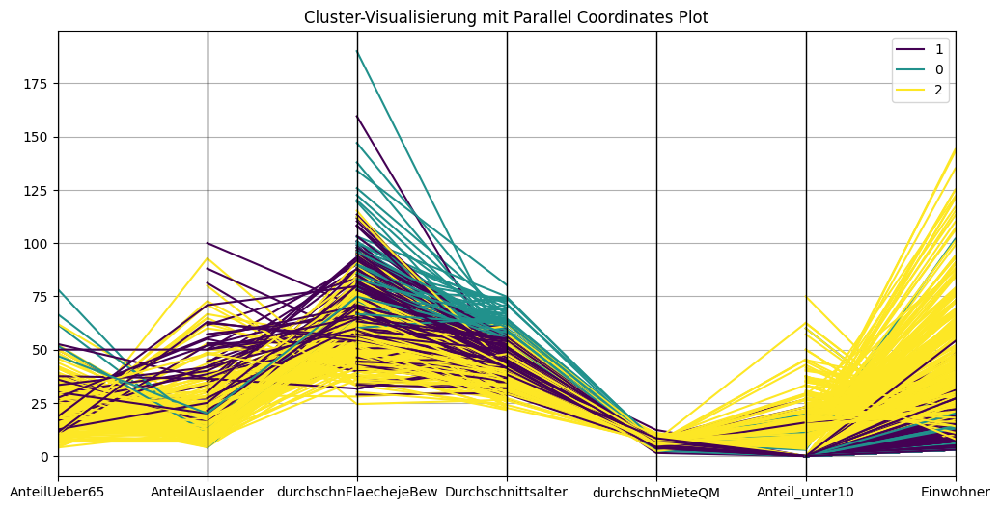

In [ ]:
from pandas.plotting import parallel_coordinates

# Erstelle den Parallel Coordinates Plot
plt.figure(figsize=(12, 6))
parallel_coordinates(Noerdlingen_df[['AnteilUeber65', 'AnteilAuslaender', 'durchschnFlaechejeBew',
                                     'Durchschnittsalter', 'durchschnMieteQM', 'Anteil_unter10', 'Einwohner', 'cluster']],
                     'cluster', colormap='viridis')
plt.title('Cluster-Visualisierung mit Parallel Coordinates Plot')
plt.show()

Clusterverteilung vor OSM

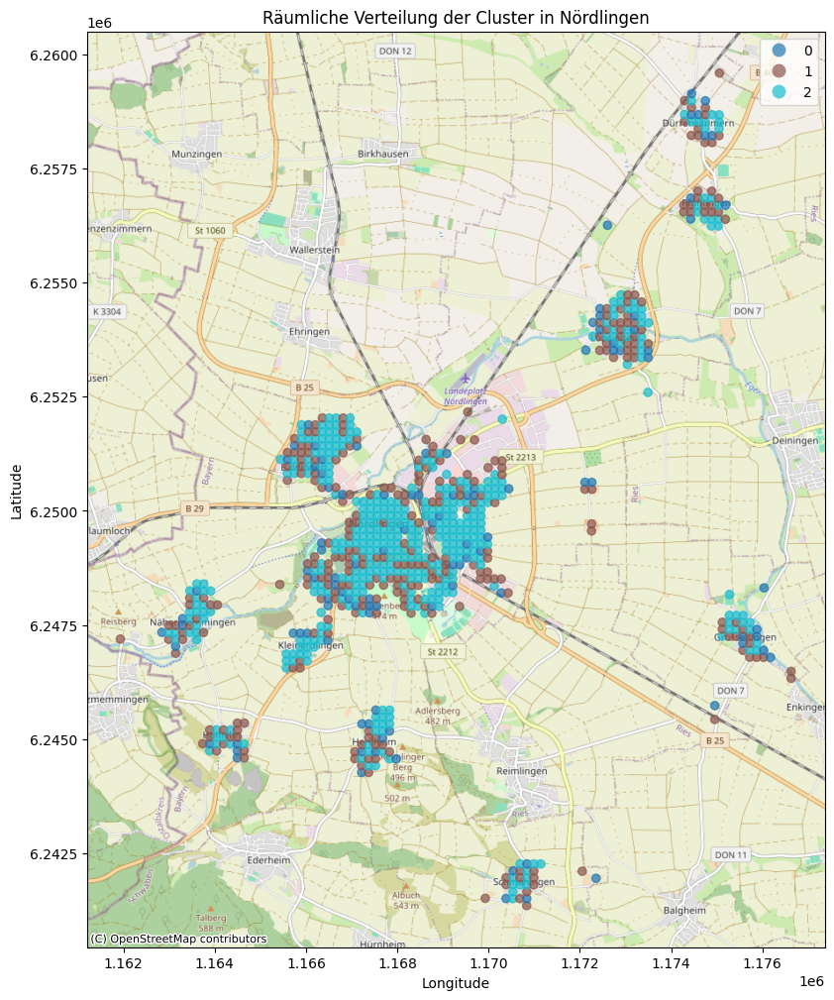

In [ ]:
# 1. Konvertiere Noerdlingen_df in ein GeoDataFrame mit dem korrekten CRS
Noerdlingen_gdf = gpd.GeoDataFrame(
    Noerdlingen_df,
    geometry=gpd.points_from_xy(Noerdlingen_df.x_mp_100m, Noerdlingen_df.y_mp_100m),
    crs="EPSG:3035"  # Setze das Koordinatenreferenzsystem auf EPSG:3035
)

# 2. Projiziere das GeoDataFrame auf Web Mercator (EPSG:3857) für die OSM-Karte
Noerdlingen_gdf = Noerdlingen_gdf.to_crs(epsg=3857)

# 3. Erstelle die Karte
fig, ax = plt.subplots(figsize=(12, 12))

# Plotte die Cluster
Noerdlingen_gdf.plot(column='cluster', categorical=True, legend=True, ax=ax, alpha=0.7)

# Füge den OSM-Hintergrund hinzu
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Setze Titel und Achsenbeschriftungen
ax.set_title('Räumliche Verteilung der Cluster in Nördlingen')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Zeige die Karte an
plt.show()

In [ ]:
# Zugriff auf die Cluster-Zentroide (Mittelwert je Cluster)
centroids = kmeans.cluster_centers_

# Ausgabe der Zentroide
print(centroids)



[[ 1.98201757  0.64414448  0.87643426  1.69614492 -0.45522701 -0.52378241
  -0.63616264]
 [-0.03081703  0.69437985  0.20050219 -0.12550355 -0.13232994 -0.64378509
  -0.5608311 ]
 [-0.50692806 -0.65869502 -0.37431487 -0.36429788  0.2141882   0.59111967
   0.56291752]]


In [ ]:
# Zugriff auf die Cluster-Zentroide
centroids = kmeans.cluster_centers_

# Dataframe aus den Zentroiden erstellen
centroid_df = pd.DataFrame(centroids, columns=X.columns, index=['Cluster 0', 'Cluster 1', 'Cluster 2'])

# Ausgabe der Tabelle
display(centroid_df)

,AnteilUeber65,AnteilAuslaender,durchschnFlaechejeBew,Durchschnittsalter,durchschnMieteQM,Anteil_unter10,Einwohner
Cluster 0,1.982018,0.644144,0.876434,1.696145,-0.455227,-0.523782,-0.636163
Cluster 1,-0.030817,0.694380,0.200502,-0.125504,-0.132330,-0.643785,-0.560831
Cluster 2,-0.506928,-0.658695,-0.374315,-0.364298,0.214188,0.591120,0.562918


Tabelle zeigt Cluster Zentroide (Mittelwert) für den jeweiligen Indikator in dem jeweiligen Cluster

=> wenn der Wert einer variable in einem cluster sehr hoch, und der einer anderen sehr niedrig isrt, kann das zur Clusterbildung geführt haben!

z.b Cluster 0: ü65 sehr hoch, u10 sehr niedrig, sowie Einwohner niedrig

# **Kempten**: K-Means Clusteranalyse

In [ ]:
from sklearn.cluster import KMeans

# 1. Wähle die relevanten Spalten für das Clustering aus.
X = Kempten_df[['AnteilUeber65',
       'AnteilAuslaender', 'durchschnFlaechejeBew', 'Durchschnittsalter','durchschnMieteQM',
       'Anteil_unter10', 'Einwohner']]

# 2. Impute missing values using KNNImputer
imputer = KNNImputer(n_neighbors=10) # You can adjust the number of neighbors
X_imputed = imputer.fit_transform(X)

# 3. Skalieren der Daten after imputation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_imputed)

# 4. Bestimme die optimale Anzahl von Clustern (z. B. mit dem Elbow-Verfahren).
n_clusters = 5

# 5. Initialisieren und Trainieren des K-Means-Modells
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(X_scaled)

# 6. Füge die Clusterzugehörigkeiten dem DataFrame hinzu
Kempten_df['cluster'] = kmeans.labels_

In [ ]:
print(Kempten_df['cluster'].value_counts())
print(Kempten_df.head())

cluster
2    566
3    341
1    327
4    229
0     78
Name: count, dtype: int64
                   GITTER_ID_100m  x_mp_100m  y_mp_100m  \
0  CRS3035RES100mN2731600E4345000    4345050    2731650   
1  CRS3035RES100mN2731700E4344700    4344750    2731750   
2  CRS3035RES100mN2731800E4342000    4342050    2731850   
3  CRS3035RES100mN2731800E4344600    4344650    2731850   
4  CRS3035RES100mN2731800E4344700    4344750    2731850   

                  geometry  AnteilUeber65  AnteilAuslaender  \
0  POINT (4345050 2731650)            NaN               NaN   
1  POINT (4344750 2731750)          50.00               NaN   
2  POINT (4342050 2731850)            NaN               NaN   
3  POINT (4344650 2731850)          14.29               NaN   
4  POINT (4344750 2731850)          29.73               NaN   

   durchschnFlaechejeBew  Durchschnittsalter  Einwohner  durchschnMieteQM  \
0                    NaN               40.47          5               NaN   
1                    NaN         

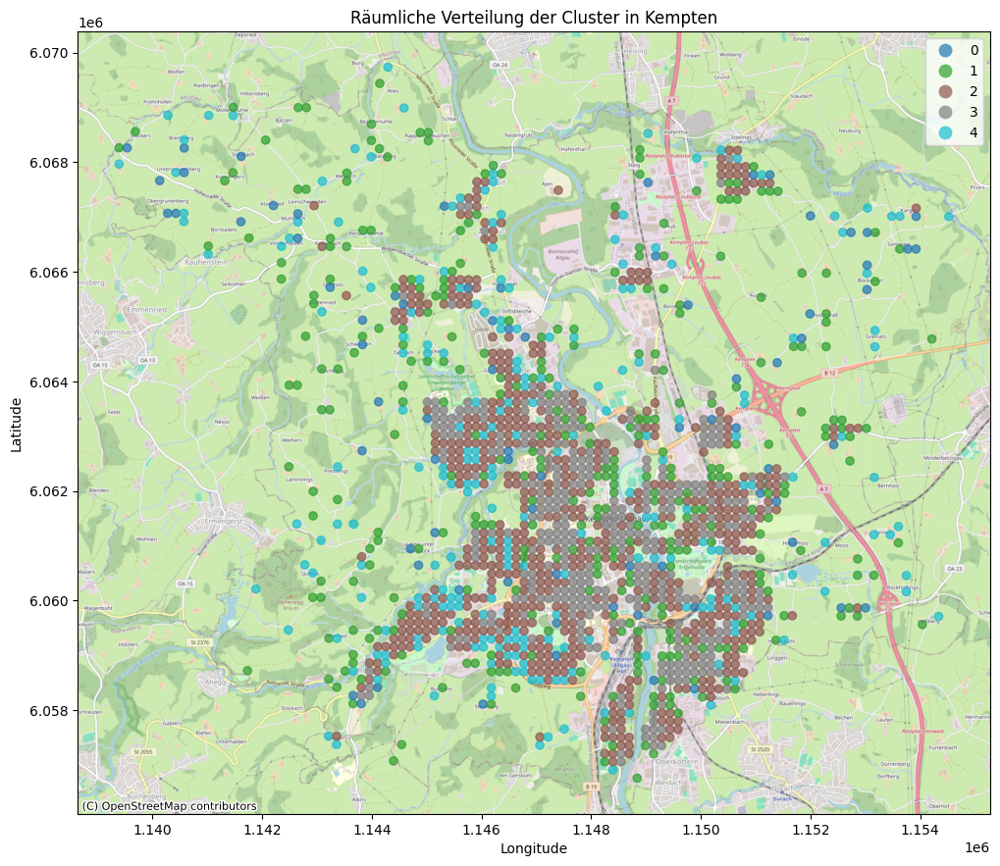

In [ ]:
# vor OSM anzeigen
# 1. Konvertiere Noerdlingen_df in ein GeoDataFrame mit dem korrekten CRS
Kempten_gdf = gpd.GeoDataFrame(
    Kempten_df,
    geometry=gpd.points_from_xy(Kempten_df.x_mp_100m, Kempten_df.y_mp_100m),
    crs="EPSG:3035"  # Setze das Koordinatenreferenzsystem auf EPSG:3035
)

# 2. Projiziere das GeoDataFrame auf Web Mercator (EPSG:3857) für die OSM-Karte
Kempten_gdf = Kempten_gdf.to_crs(epsg=3857)

# 3. Erstelle die Karte
fig, ax = plt.subplots(figsize=(12, 12))

# Plotte die Cluster
Kempten_gdf.plot(column='cluster', categorical=True, legend=True, ax=ax, alpha=0.7)

# Füge den OSM-Hintergrund hinzu
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Setze Titel und Achsenbeschriftungen
ax.set_title('Räumliche Verteilung der Cluster in Kempten')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Zeige die Karte an
plt.show()

In [ ]:
# Zugriff auf die Cluster-Zentroide
centroids = kmeans.cluster_centers_

# Ausgabe der Zentroide
print(centroids)


[[-0.09511203  1.58976839 -0.64081068 -1.47566069  0.00438445  3.17038797
  -0.69691899]
 [-0.06546009  1.03022326 -0.2376857  -0.67467131 -0.27384096 -0.39508507
  -0.66371648]
 [-0.22168103 -0.71919829  0.11182806  0.19767562  0.19991366 -0.04130136
  -0.09435315]
 [-0.72075949 -0.45723242 -0.65778252 -0.34455467  0.15877749  0.1379775
   1.44430169]
 [ 1.75787456  0.44980167  1.26918158  1.49856293 -0.34319748 -0.62240868
  -0.74189616]]


In [ ]:
# Zugriff auf die Cluster-Zentroide
centroids = kmeans.cluster_centers_

# Dataframe aus den Zentroiden erstellen
centroid_df = pd.DataFrame(centroids, columns=X.columns, index=['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4'])

# Ausgabe der Tabelle
display(centroid_df)

,AnteilUeber65,AnteilAuslaender,durchschnFlaechejeBew,Durchschnittsalter,durchschnMieteQM,Anteil_unter10,Einwohner
Cluster 0,-0.095112,1.589768,-0.640811,-1.475661,0.004384,3.170388,-0.696919
Cluster 1,-0.065460,1.030223,-0.237686,-0.674671,-0.273841,-0.395085,-0.663716
Cluster 2,-0.221681,-0.719198,0.111828,0.197676,0.199914,-0.041301,-0.094353
Cluster 3,-0.720759,-0.457232,-0.657783,-0.344555,0.158777,0.137978,1.444302
Cluster 4,1.757875,0.449802,1.269182,1.498563,-0.343197,-0.622409,-0.741896


# **Ingolstadt K-Means Clustering**

In [ ]:
# 1. Wähle die relevanten Spalten für das Clustering aus.
X = Ingolstadt_df[['AnteilUeber65',
       'AnteilAuslaender', 'durchschnFlaechejeBew', 'Durchschnittsalter','durchschnMieteQM',
       'Anteil_unter10', 'Einwohner']]

# 2. Impute missing values using KNNImputer
imputer = KNNImputer(n_neighbors=10) # You can adjust the number of neighbors
X_imputed = imputer.fit_transform(X)

# 3. Skalieren der Daten after imputation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_imputed)

# 4. Bestimme die optimale Anzahl von Clustern (z. B. mit dem Elbow-Verfahren).
n_clusters = 5

# 5. Initialisieren und Trainieren des K-Means-Modells
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(X_scaled)

# 6. Füge die Clusterzugehörigkeiten dem DataFrame hinzu
Ingolstadt_df['cluster'] = kmeans.labels_

In [ ]:
print(Ingolstadt_df['cluster'].value_counts())
print(Ingolstadt_df.head())

cluster
0    1221
3    1042
2     328
1     287
4     250
Name: count, dtype: int64
                   GITTER_ID_100m  x_mp_100m  y_mp_100m  \
0  CRS3035RES100mN2843300E4424300    4424350    2843350   
1  CRS3035RES100mN2843700E4425900    4425950    2843750   
2  CRS3035RES100mN2843700E4426000    4426050    2843750   
3  CRS3035RES100mN2843800E4423200    4423250    2843850   
4  CRS3035RES100mN2843800E4423300    4423350    2843850   

                  geometry  AnteilUeber65  AnteilAuslaender  \
0  POINT (4424350 2843350)            NaN               NaN   
1  POINT (4425950 2843750)            NaN               NaN   
2  POINT (4426050 2843750)            NaN               NaN   
3  POINT (4423250 2843850)          42.86               NaN   
4  POINT (4423350 2843850)            NaN               NaN   

   durchschnFlaechejeBew  Durchschnittsalter  Einwohner  durchschnMieteQM  \
0                  62.50               36.53          3               NaN   
1                  98.99    

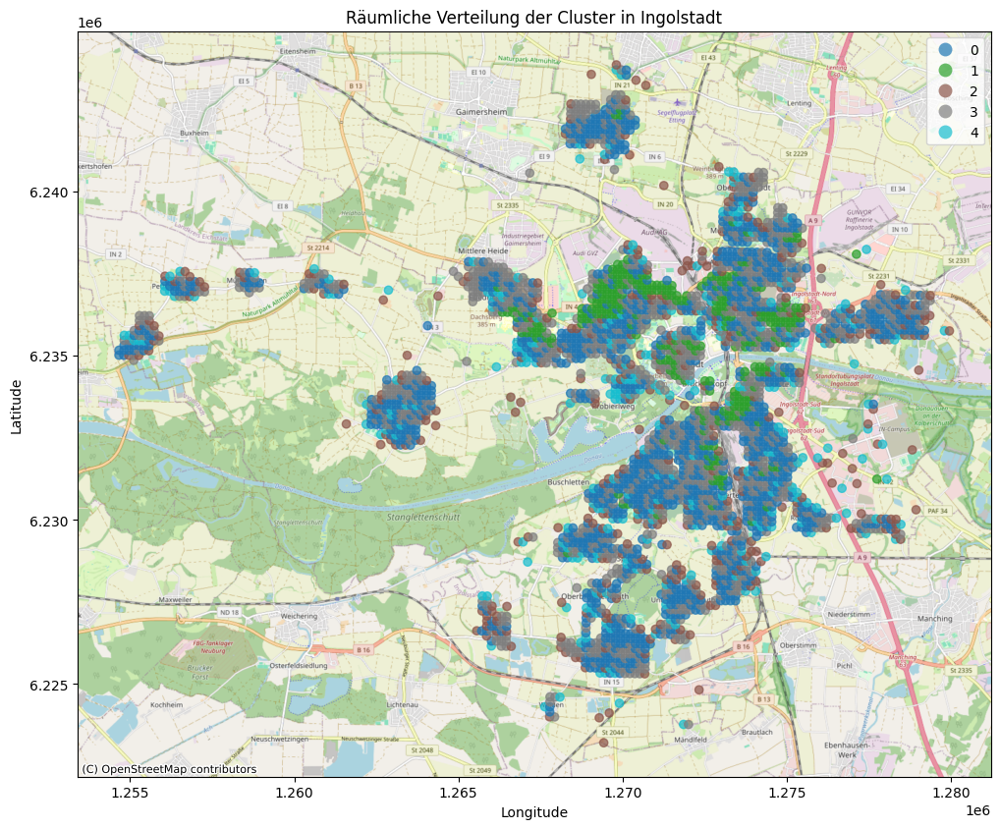

In [ ]:
# vor OSM anzeigen
# 1. Konvertiere Noerdlingen_df in ein GeoDataFrame mit dem korrekten CRS
Ingolstadt_gdf = gpd.GeoDataFrame(
    Ingolstadt_df,
    geometry=gpd.points_from_xy(Ingolstadt_df.x_mp_100m, Ingolstadt_df.y_mp_100m),
    crs="EPSG:3035"  # Setze das Koordinatenreferenzsystem auf EPSG:3035
)

# 2. Projiziere das GeoDataFrame auf Web Mercator (EPSG:3857) für die OSM-Karte
Ingolstadt_gdf = Ingolstadt_gdf.to_crs(epsg=3857)

# 3. Erstelle die Karte
fig, ax = plt.subplots(figsize=(12, 12))

# Plotte die Cluster
Ingolstadt_gdf.plot(column='cluster', categorical=True, legend=True, ax=ax, alpha=0.7)

# Füge den OSM-Hintergrund hinzu
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Setze Titel und Achsenbeschriftungen
ax.set_title('Räumliche Verteilung der Cluster in Ingolstadt')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Zeige die Karte an
plt.show()

In [ ]:
# Zugriff auf die Cluster-Zentroide
centroids = kmeans.cluster_centers_

# Dataframe aus den Zentroiden erstellen
centroid_df = pd.DataFrame(centroids, columns=X.columns, index=['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4'])

# Ausgabe der Tabelle
display(centroid_df)

,AnteilUeber65,AnteilAuslaender,durchschnFlaechejeBew,Durchschnittsalter,durchschnMieteQM,Anteil_unter10,Einwohner
Cluster 0,0.077943,-0.516935,0.239300,0.455919,-0.288440,-0.277423,-0.213166
Cluster 1,-0.535168,0.256136,-0.979301,-0.312195,-0.683754,0.067157,2.370772
Cluster 2,0.325230,1.883141,-0.195726,-0.612403,0.404459,-0.793393,-0.796664
Cluster 3,-0.609743,-0.317969,-0.347575,-0.703315,0.447863,0.755953,0.029175
Cluster 4,2.347418,1.075681,1.662723,1.870858,-0.206420,-0.829976,-0.754591


Cluster-Spalte extrahieren und als eigene Datei abspeichern

In [ ]:
# Für Noerdlingen_df:
Noerdlingen_cluster = Noerdlingen_df[['GITTER_ID_100m', 'x_mp_100m', 'y_mp_100m', 'cluster']]
Noerdlingen_cluster.to_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/Noerdlingen_cluster.csv', index=False)
# Added a file name to the path

In [ ]:
Kempten_cluster = Kempten_df[['GITTER_ID_100m', 'x_mp_100m', 'y_mp_100m', 'cluster']]
Kempten_cluster.to_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/Kempten_cluster.csv', index=False)

Ingolstadt_cluster = Ingolstadt_df[['GITTER_ID_100m', 'x_mp_100m', 'y_mp_100m', 'cluster']]
Ingolstadt_cluster.to_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/Ingolstadt_cluster.csv', index=False)

In [ ]:
print(Noerdlingen_cluster.head())
print(Kempten_cluster.head())
print(Ingolstadt_cluster.head())

                   GITTER_ID_100m  x_mp_100m  y_mp_100m  cluster
0  CRS3035RES100mN2854400E4359000    4359050    2854450        1
1  CRS3035RES100mN2854500E4358400    4358450    2854550        1
2  CRS3035RES100mN2854500E4358700    4358750    2854550        0
3  CRS3035RES100mN2854500E4358800    4358850    2854550        2
4  CRS3035RES100mN2854500E4358900    4358950    2854550        1
                   GITTER_ID_100m  x_mp_100m  y_mp_100m  cluster
0  CRS3035RES100mN2731600E4345000    4345050    2731650        1
1  CRS3035RES100mN2731700E4344700    4344750    2731750        4
2  CRS3035RES100mN2731800E4342000    4342050    2731850        1
3  CRS3035RES100mN2731800E4344600    4344650    2731850        1
4  CRS3035RES100mN2731800E4344700    4344750    2731850        2
                   GITTER_ID_100m  x_mp_100m  y_mp_100m  cluster
0  CRS3035RES100mN2843300E4424300    4424350    2843350        2
1  CRS3035RES100mN2843700E4425900    4425950    2843750        4
2  CRS3035RES100mN2843700

# einzelne Variablen auf Karte visualisieren

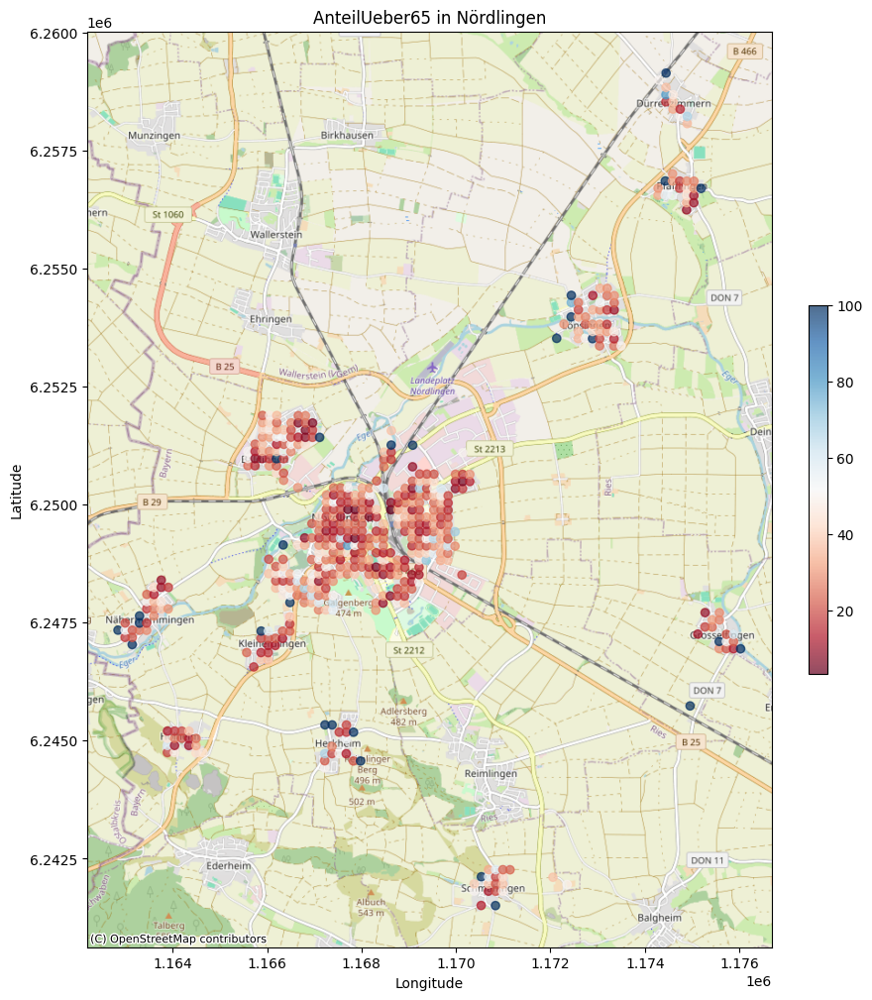

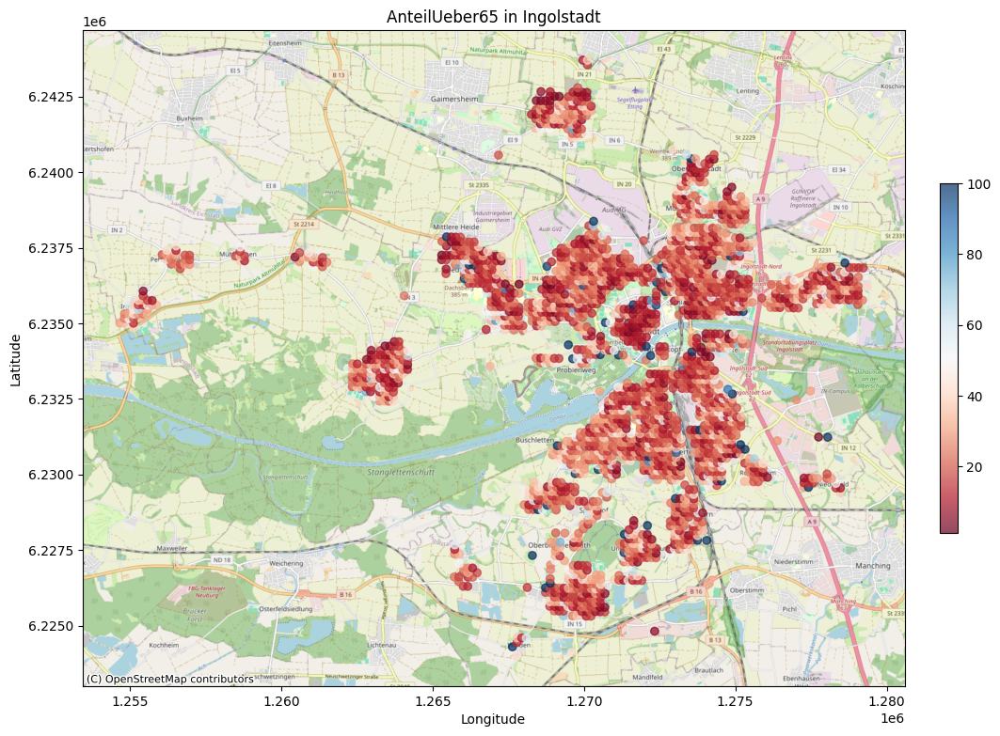

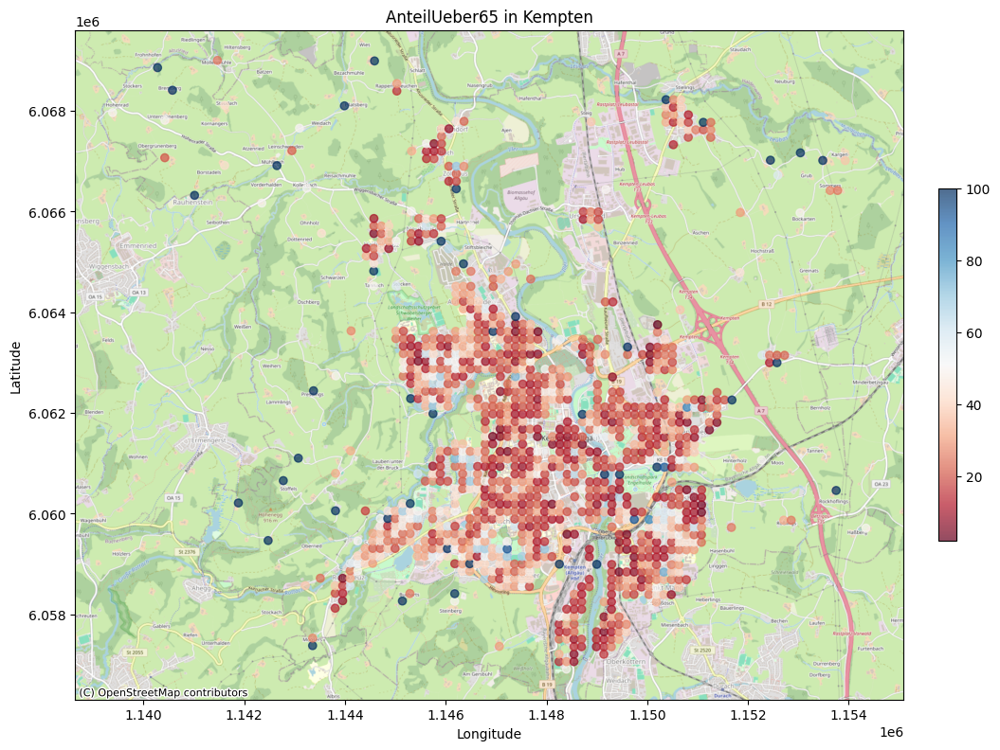

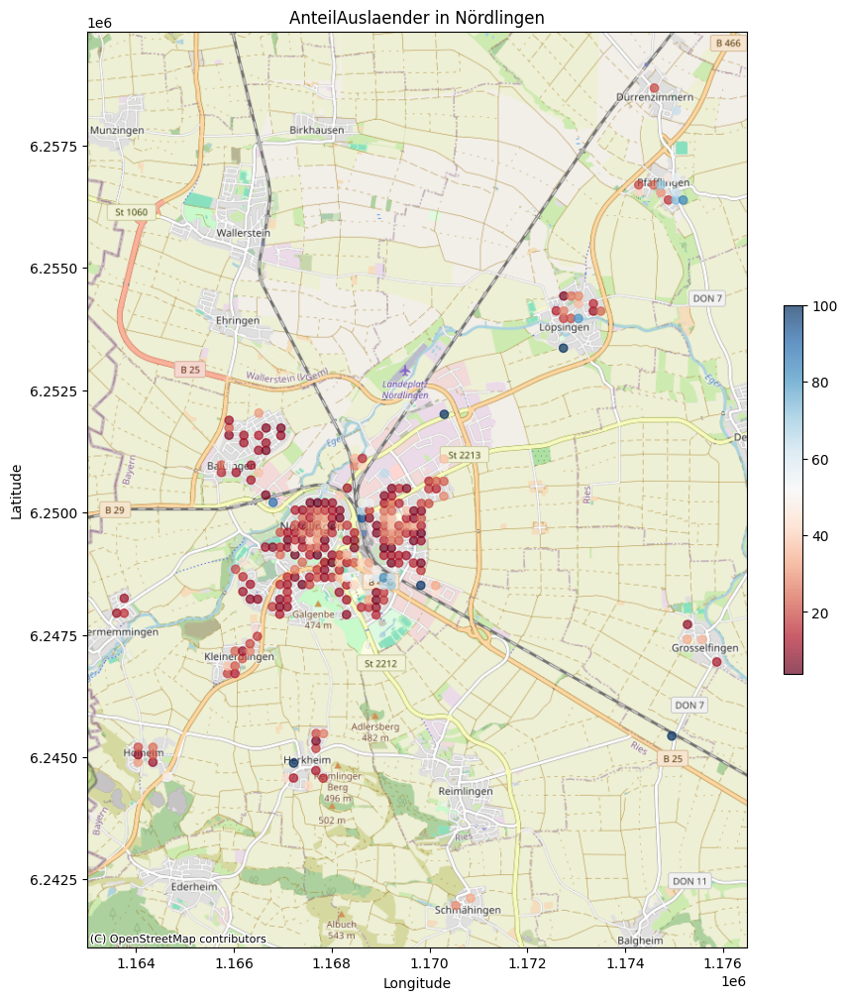

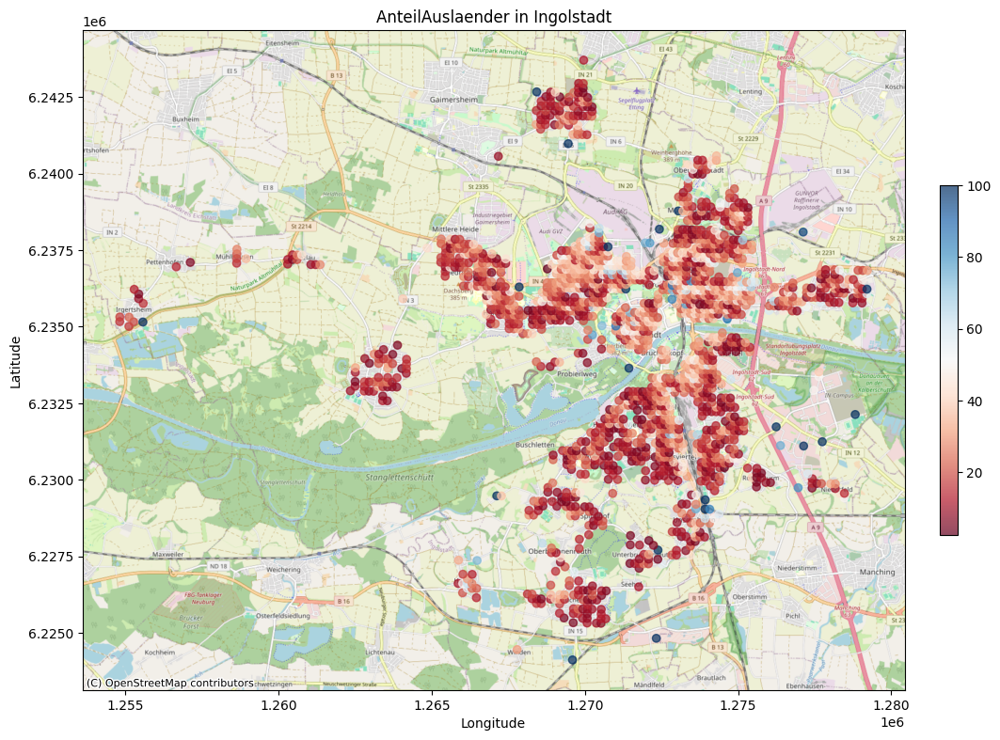

...

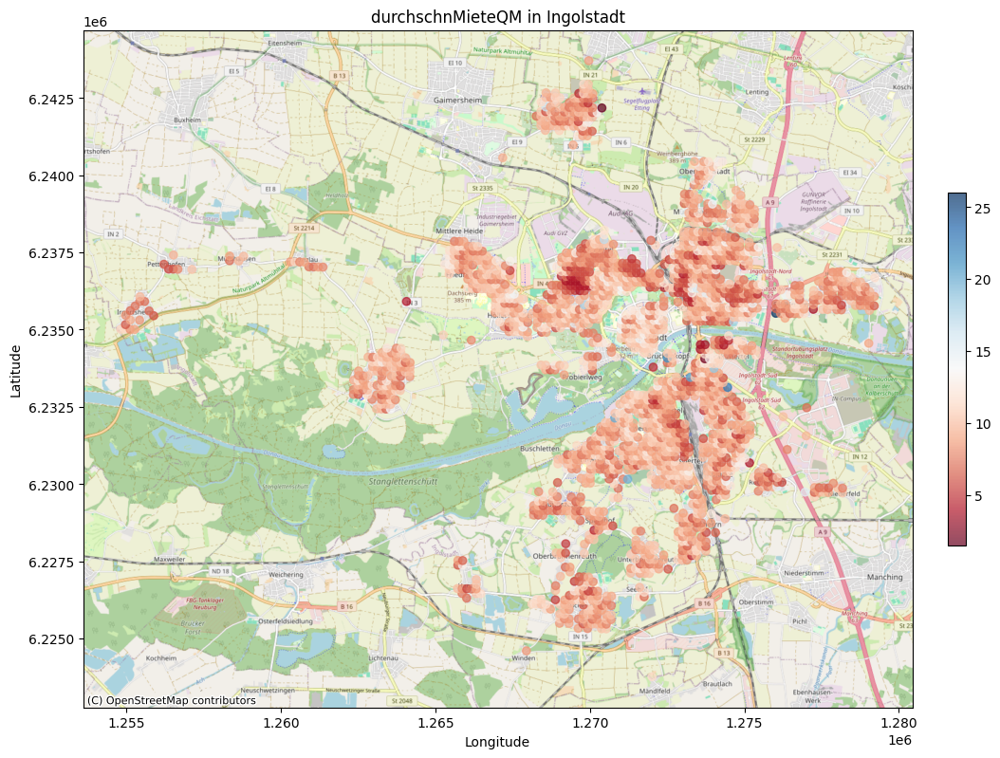

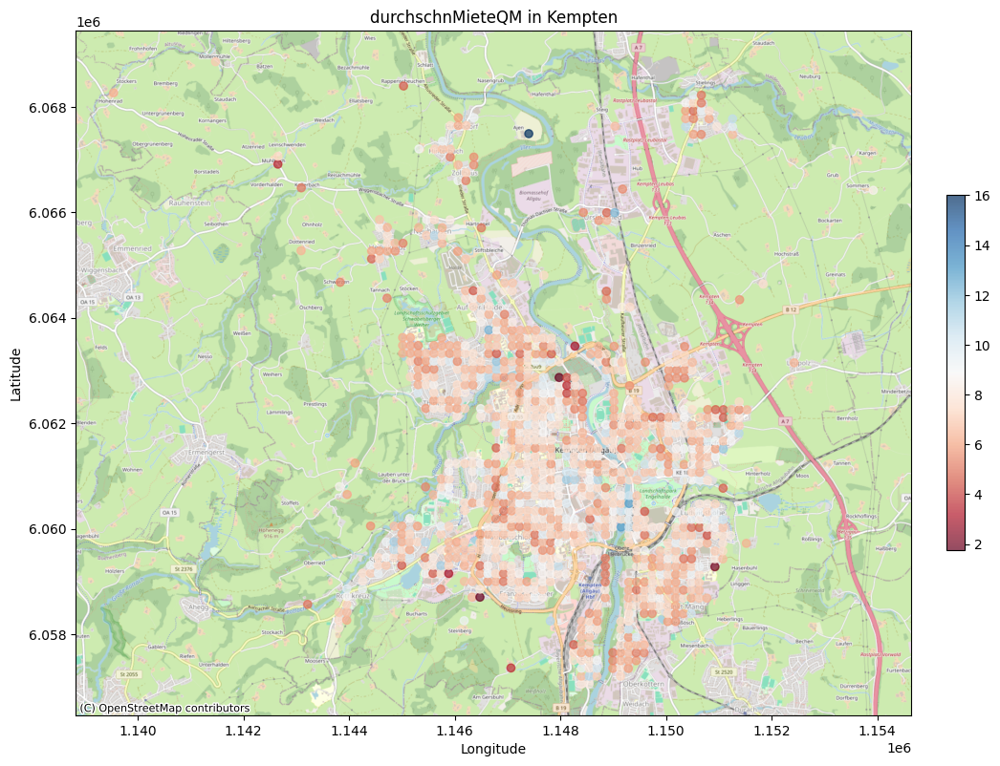

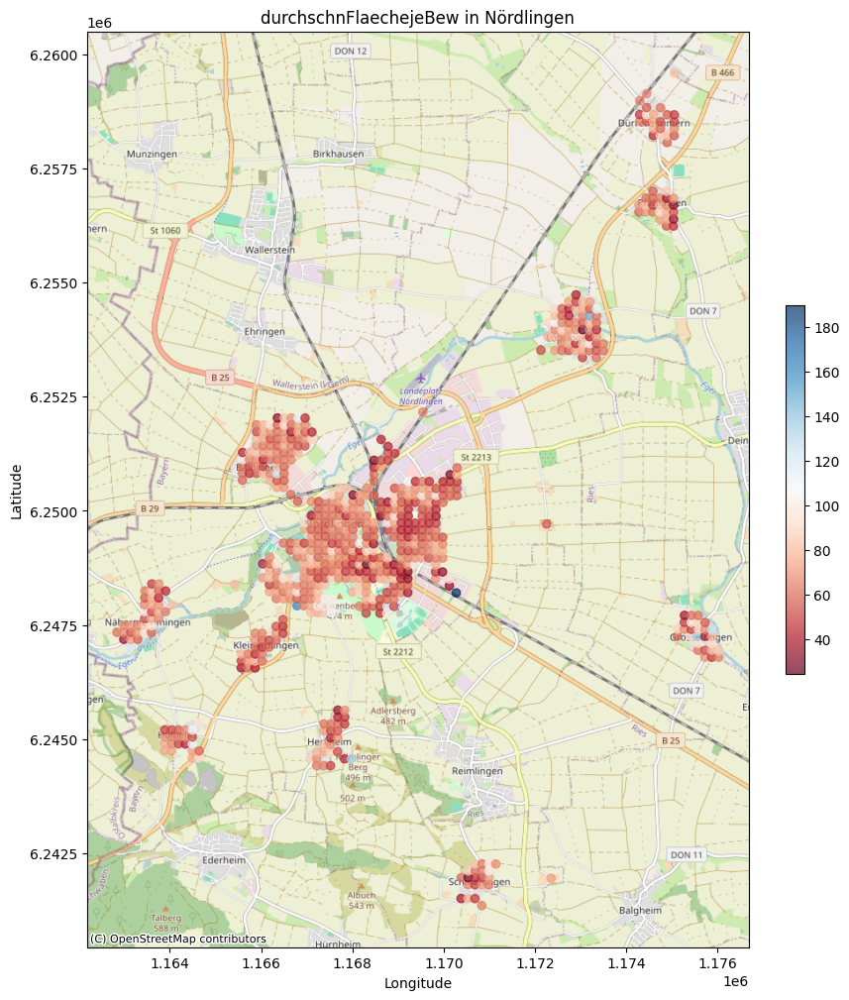

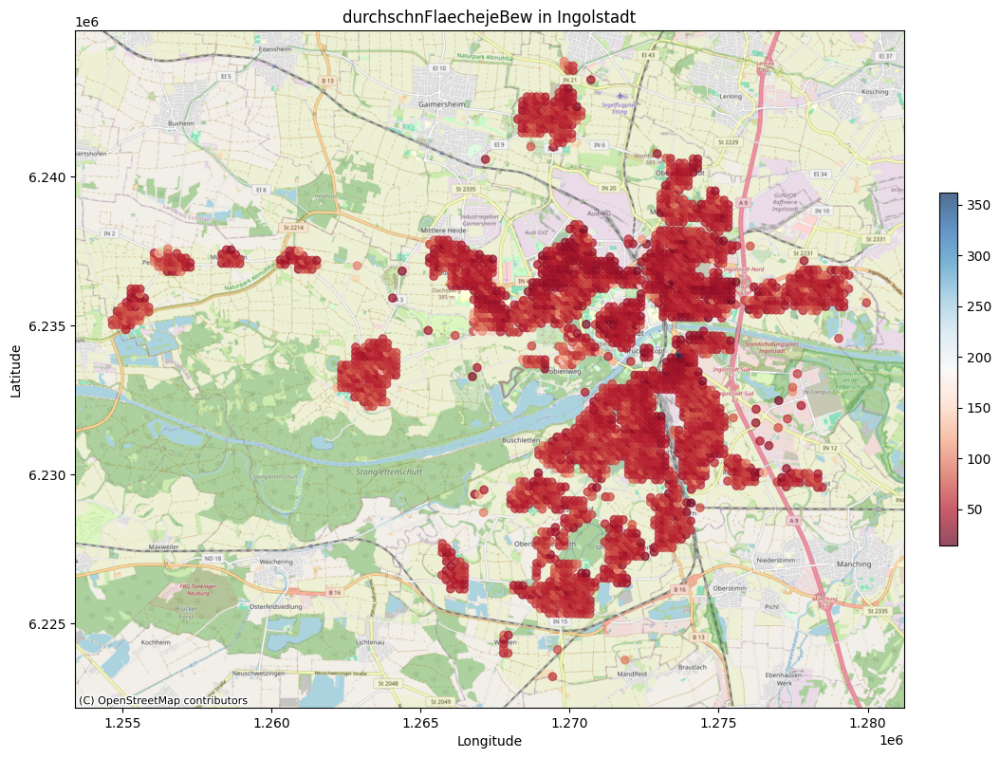

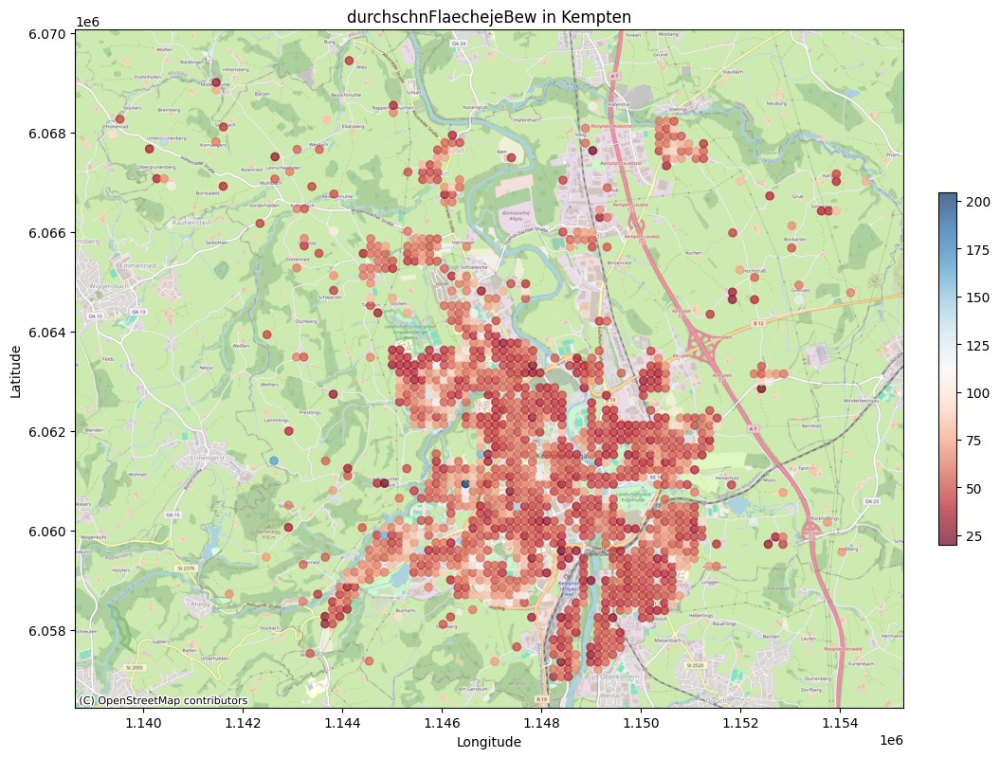

In [ ]:
# Funktion zur Visualisierung einer Variable
def visualisiere_variable(gdf, variable, titel):
    """
    Visualisiert die räumliche Verteilung einer Variable auf einer OSM-Karte.

    Args:
        gdf: GeoDataFrame mit den Daten.
        variable: Name der zu visualisierenden Spalte.
        titel: Titel der Karte.
    """

    # 1. Projiziere das GeoDataFrame auf Web Mercator (EPSG:3857) für die OSM-Karte
    gdf = gdf.to_crs(epsg=3857)

    # 2. Erstelle die Karte
    fig, ax = plt.subplots(figsize=(12, 12))

    # 3. Plotte die Variable and store the return value
    #    The return value is a collection of artists and is a mappable
    plot = gdf.plot(column=variable, cmap='RdBu', legend=False, ax=ax, alpha=0.7)
    # create a colorbar using the 'plot' variable's collection
    fig.colorbar(plot.collections[0], ax=ax, fraction=0.02, pad=0.04)

    # 4. Füge den OSM-Hintergrund hinzu
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

    # 5. Setze Titel und Achsenbeschriftungen
    ax.set_title(titel)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # 6. Zeige die Karte an
    plt.show()


# Erstelle GeoDataFrames für Nördlingen, Ingolstadt und Kempten
# und transformiere sie direkt zum OSM-Koordinatensystem
Noerdlingen_gdf = gpd.GeoDataFrame(
    Noerdlingen_df,
    geometry=gpd.points_from_xy(Noerdlingen_df.x_mp_100m, Noerdlingen_df.y_mp_100m),
    crs="EPSG:3035"
).to_crs(epsg=3857)  # Transformation zum OSM-Koordinatensystem
Ingolstadt_gdf = gpd.GeoDataFrame(
    Ingolstadt_df,
    geometry=gpd.points_from_xy(Ingolstadt_df.x_mp_100m, Ingolstadt_df.y_mp_100m),
    crs="EPSG:3035"
).to_crs(epsg=3857)  # Transformation zum OSM-Koordinatensystem
Kempten_gdf = gpd.GeoDataFrame(
    Kempten_df,
    geometry=gpd.points_from_xy(Kempten_df.x_mp_100m, Kempten_df.y_mp_100m),
    crs="EPSG:3035"
).to_crs(epsg=3857)  # Transformation zum OSM-Koordinatensystem

# Definiere die zu visualisierenden Variablen
variablen = ['AnteilUeber65', 'AnteilAuslaender', 'Anteil_unter10', 'durchschnMieteQM', 'durchschnFlaechejeBew']

# Visualisiere die Variablen für jeden Datensatz
for variable in variablen:
    visualisiere_variable(Noerdlingen_gdf, variable, f'{variable} in Nördlingen')
    visualisiere_variable(Ingolstadt_gdf, variable, f'{variable} in Ingolstadt')
    visualisiere_variable(Kempten_gdf, variable, f'{variable} in Kempten')

# alle 3 Städte zusammen Clustern

In [9]:
# 1. Datenvorbereitung
df = pd.concat([Noerdlingen_df, Kempten_df, Ingolstadt_df]) # Städte werden untereinander gelistet
features = ['AnteilUeber65', 'AnteilAuslaender', 'durchschnFlaechejeBew', 'Durchschnittsalter',
             'durchschnMieteQM', 'Anteil_unter10', 'Einwohner']
X = df[features]
imputer = KNNImputer(n_neighbors=5)
X_imputed = imputer.fit_transform(X)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_imputed)


In [10]:
print(X.columns)
print(X.head)

Index(['AnteilUeber65', 'AnteilAuslaender', 'durchschnFlaechejeBew',
       'Durchschnittsalter', 'durchschnMieteQM', 'Anteil_unter10',
       'Einwohner'],
      dtype='object')
<bound method NDFrame.head of       AnteilUeber65  AnteilAuslaender  durchschnFlaechejeBew  \
0               NaN               NaN                  65.00   
1               NaN               NaN                    NaN   
2               NaN               NaN                  39.04   
3             13.64               NaN                  78.77   
4               NaN               NaN                  48.23   
...             ...               ...                    ...   
3123          14.29               NaN                  54.63   
3124            NaN               NaN                 107.92   
3125           9.52              11.9                  61.30   
3126          40.00               NaN                  67.85   
3127            NaN               NaN                 102.25   

      Durchschnittsalt

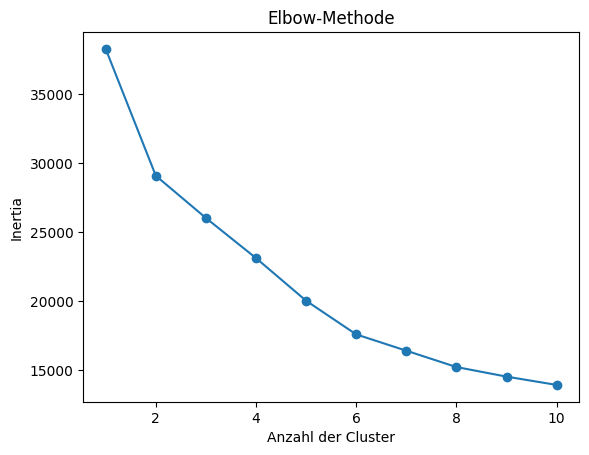

In [11]:
# 2. Bestimmung der optimalen Clusteranzahl (Elbow-Methode)
inertia = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Elbow-Methode')
plt.xlabel('Anzahl der Cluster')
plt.ylabel('Inertia')
plt.show()

In [12]:
# 3. K-Means Clustering (mit 5 Clustern)
kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(X_scaled) # Get cluster labels


In [13]:
# 4. Clusterzugehörigkeiten zum ursprünglichen DataFrame hinzufügen
df['cluster'] = cluster_labels # Add cluster labels to original DataFrame


In [14]:
# 5. Auswertung und Visualisierung
print(df['cluster'].value_counts())
print(df.head(10)) # Access desired columns

cluster
1    1884
3    1845
4     814
2     516
0     407
Name: count, dtype: int64
                   GITTER_ID_100m  x_mp_100m  y_mp_100m  \
0  CRS3035RES100mN2854400E4359000    4359050    2854450   
1  CRS3035RES100mN2854500E4358400    4358450    2854550   
2  CRS3035RES100mN2854500E4358700    4358750    2854550   
3  CRS3035RES100mN2854500E4358800    4358850    2854550   
4  CRS3035RES100mN2854500E4358900    4358950    2854550   
5  CRS3035RES100mN2854500E4359000    4359050    2854550   
6  CRS3035RES100mN2854600E4358800    4358850    2854650   
7  CRS3035RES100mN2854600E4359000    4359050    2854650   
8  CRS3035RES100mN2854700E4358700    4358750    2854750   
9  CRS3035RES100mN2854700E4358800    4358850    2854750   

                  geometry  AnteilUeber65  AnteilAuslaender  \
0  POINT (4359050 2854450)            NaN               NaN   
1  POINT (4358450 2854550)            NaN               NaN   
2  POINT (4358750 2854550)            NaN               NaN   
3  POINT (4358

In [15]:
df['cluster'] = df['cluster'] + 1
df = df.drop(columns=['Unter10', 'Insgesamt_Bevoelkerung'])

In [ ]:
df.to_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/alle_staedte_cluster.csv', index=False)


In [17]:
alle_staedte_cluster = pd.read_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/alle_staedte_cluster.csv')


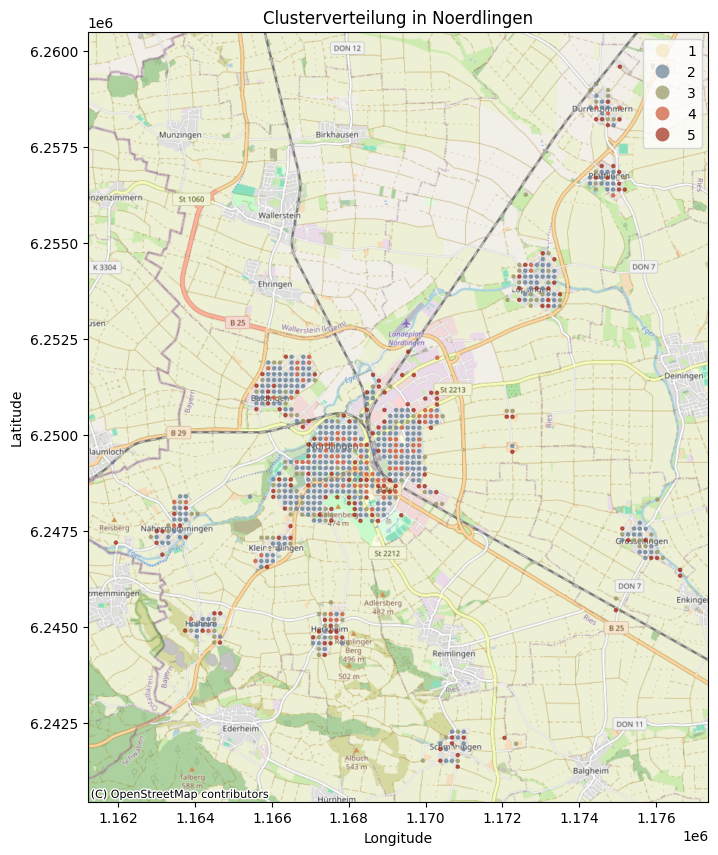

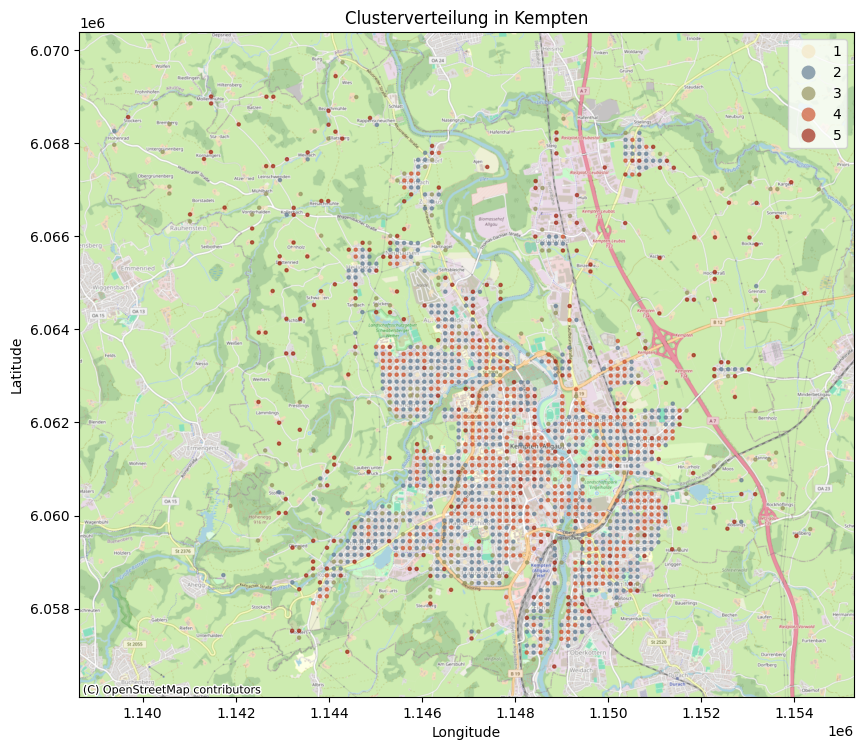

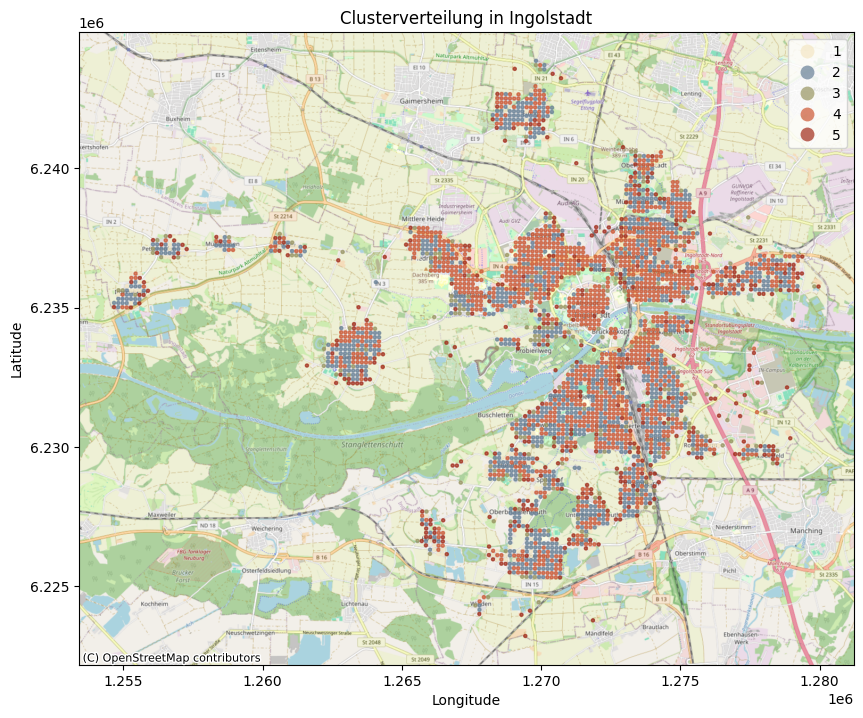

In [39]:
# 1. Daten aus der CSV-Datei laden
alle_staedte_cluster = pd.read_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/alle_staedte_cluster.csv')

from pypalettes import load_cmap
cmap = load_cmap("ArcticGates")

# 2. Städte und deren Daten definieren
cities = {
    "Noerdlingen": alle_staedte_cluster.iloc[:len(Noerdlingen_df)],  # Daten für Nördlingen
    "Kempten": alle_staedte_cluster.iloc[len(Noerdlingen_df):len(Noerdlingen_df) + len(Kempten_df)],  # Daten für Kempten
    "Ingolstadt": alle_staedte_cluster.iloc[len(Noerdlingen_df) + len(Kempten_df):],  # Daten für Ingolstadt
}

# 3. Für jede Stadt eine Karte erstellen
for city_name, city_data in cities.items():
    # GeoDataFrame erstellen
    gdf = gpd.GeoDataFrame(
        city_data,
        geometry=gpd.points_from_xy(city_data.x_mp_100m, city_data.y_mp_100m),
        crs="EPSG:3035"
    ).to_crs(epsg=3857)

    # Karte erstellen
    fig, ax = plt.subplots(figsize=(10, 10))
    gdf.plot(column='cluster', categorical=True, legend=True, ax=ax, alpha=0.7, markersize=5, cmap=cmap) # cmap hinzugefügt
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title(f'Clusterverteilung in {city_name}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    plt.show()

In [18]:
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns=features, index=[f'Cluster {i}' for i in range(5)])
display(centroid_df)

,AnteilUeber65,AnteilAuslaender,durchschnFlaechejeBew,Durchschnittsalter,durchschnMieteQM,Anteil_unter10,Einwohner
Cluster 0,-0.137101,0.432810,-0.317917,-1.217318,-0.103339,2.413229,-0.568744
Cluster 1,0.012125,-0.583323,0.241219,0.386018,-0.367590,-0.173478,-0.154140
Cluster 2,2.204856,1.010913,1.464804,1.835348,-0.556786,-0.762539,-0.765672
Cluster 3,-0.689077,-0.432667,-0.571097,-0.431451,0.535638,0.189118,0.840409
Cluster 4,0.200990,1.471761,-0.037101,-0.473258,0.045267,-0.747885,-0.772718


Zentroid-Output zeigt jetzt Verteilung der einzelnen Variablen im jeweiligen Cluster, anhand davon kann jetzt interpretiert werden


In [31]:
from pypalettes import load_cmap
cmap = load_cmap("ArcticGates")
cmap = load_cmap("Antique")
cmap = load_cmap("Demuth")
cmap = load_cmap("GrandCanyon")

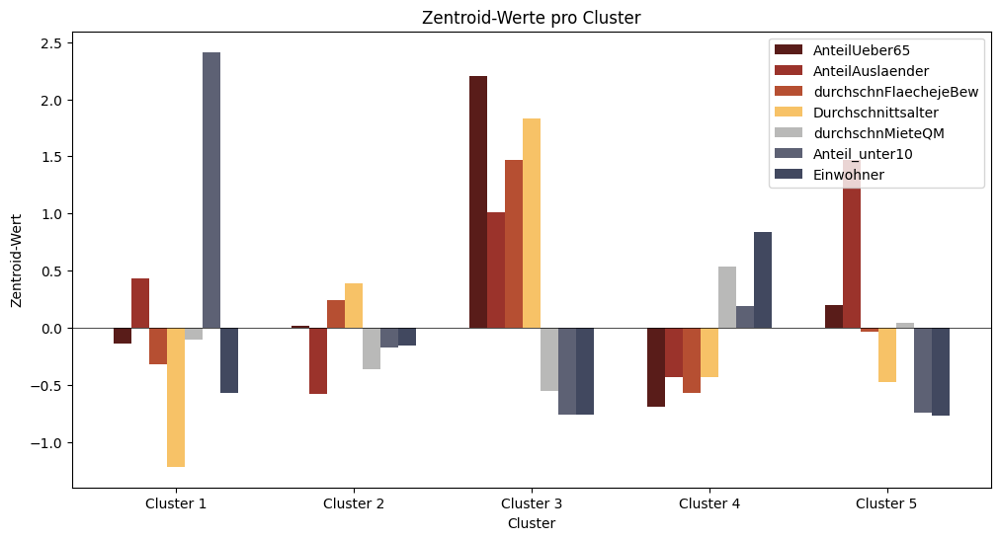

In [35]:
# Balkendiagramm aus Zentroid-Daten

# Zentroid-Daten aus dem DataFrame extrahieren
cluster_names = [f'Cluster {i+1}' for i in range(5)]  # Clusternamen von 1-5
variables = centroid_df.columns  # Variablennamen
centroid_values = centroid_df.values  # Zentroid-Werte

# Lade die Farbpalette
cmap = load_cmap("Demuth")

# Farben für die Variablen definieren (anstatt der vorherigen Liste)
colors = [cmap(i / len(variables)) for i in range(len(variables))]

# Breite der Balken und Positionen festlegen
bar_width = 0.1
index = np.arange(len(cluster_names))

# Balkendiagramm erstellen
fig, ax = plt.subplots(figsize=(12, 6))
for i, variable in enumerate(variables):
    ax.bar(index + i * bar_width, centroid_values[:, i], bar_width, label=variable, color=colors[i])

# Achsenbeschriftungen und Legende hinzufügen
ax.set_xlabel('Cluster')
ax.set_ylabel('Zentroid-Wert')
ax.set_xticks(index + bar_width * (len(variables) -1) / 2)  # Zentrierte x-Achsenbeschriftungen
ax.set_xticklabels(cluster_names)
ax.legend()

# Horizontale Linie bei y=0 einzeichnen
ax.axhline(0, color='black', linewidth=0.5)  # Ändere Farbe und Linienstärke nach Bedarf


# Titel hinzufügen
plt.title('Zentroid-Werte pro Cluster')

# Diagramm anzeigen
plt.show()


Variablen noch umbenennen, Schriftart ändern,...